In [ ]:
# Importing necessary libraries.
import csv
import requests
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
# Read the downloaded Excel file to a DataFrame
df = pd.read_excel('ERC Database.xlsx')

# Printing the dataframe
df

,Project Number,Call,Acronym,EU contribution,Researcher(s),Host Institution(s),Project Title,Panel,_abstract
0,101116083,ERC-2023-STG,ACTIVATE,1499738.0,Norbert Pirk,Universitetet I Oslo (NO),Actively learning experimental designs in terr...,PE10 - Earth System Science,"While land-atmosphere exchanges of carbon, wat..."
1,101118083,ERC-2023-STG,AQUAGUARD,1498561.0,Miina Porkka,Aalto Korkeakoulusaatio Sr (FI),Protecting the planet’s bloodstream: feasible ...,"SH7 - Human Mobility, Environment & Space",Freshwater has a fundamental role in regulatin...
2,101115429,ERC-2023-STG,AstroMol,1461701.0,Tamar Stein,The Hebrew University Of Jerusalem (IL),Chemical Transformations in the Inter-Stellar ...,PE4 - Physical & Analytical Chemical Sciences,"Until the beginning of the last century, the s..."
3,101116722,ERC-2023-STG,BattSkin,1499900.0,Minghao Yu,Technische Universitaet Dresden (DE),Practical magnesium batteries enabled by 2D cr...,PE11 - Materials Engineering,The intrinsic limitation of Li-ion batteries (...
4,101116544,ERC-2023-STG,BifurCAT,1500000.0,Golo Storch,Technische Universitaet Muenchen (DE),Artificial Catalysts for Endergonic Reduction ...,PE5 - Synthetic Chemistry & Materials,Endergonic catalysis converts low-energy subst...
...,...,...,...,...,...,...,...,...,...
14756,202984,ERC-2007-STG,UNICON,500000.0,Johan Hoffman,Kungliga Tekniska Hoegskolan (SE),New Adaptive Computational Methods for Fluid-S...,PE1 - Mathematics,For many problems involving a fluid and a stru...
14757,205175,ERC-2007-STG,USEMS,1992000.0,Giulio Di Toro,Istituto Nazionale Di Geofisica E Vulcanologia...,Uncovering the Secrets of an Earthquake: Multi...,PE8 - Products & Processes Engineering,Understanding the physico-chemical processes c...
14758,207573,ERC-2007-STG,Vectorial Problems,500000.0,Giuseppe Mingione,Universita Degli Studi Di Parma (IT),"Vectorial Elliptic, Parabolic and Variational ...",PE1 - Mathematics,The aim of the proposed project is to start a ...
14759,200749,ERC-2007-STG,VNALG,500000.0,Stefaan Vaes,Katholieke Universiteit Leuven (BE),"Von Neumann algebras, group actions and discre...",PE1 - Mathematics,"Von Neumann algebras, and more specifically II..."


In [ ]:
# Specify the columns you want to fetch
columns_to_fetch = ["Project Title", "_abstract"]

# Fetch the desired columns
df_selected = df[columns_to_fetch]

# Extract years from the "Call" column
df_selected['Year'] = df['Call'].str.extract(r'(\d{4})')

# Print the selected df
df_selected

<ipython-input-11-0d398dbcd50a>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected['Year'] = df['Call'].str.extract(r'(\d{4})')


,Project Title,_abstract,Year
0,Actively learning experimental designs in terr...,"While land-atmosphere exchanges of carbon, wat...",2023
1,Protecting the planet’s bloodstream: feasible ...,Freshwater has a fundamental role in regulatin...,2023
2,Chemical Transformations in the Inter-Stellar ...,"Until the beginning of the last century, the s...",2023
3,Practical magnesium batteries enabled by 2D cr...,The intrinsic limitation of Li-ion batteries (...,2023
4,Artificial Catalysts for Endergonic Reduction ...,Endergonic catalysis converts low-energy subst...,2023
...,...,...,...
14756,New Adaptive Computational Methods for Fluid-S...,For many problems involving a fluid and a stru...,2007
14757,Uncovering the Secrets of an Earthquake: Multi...,Understanding the physico-chemical processes c...,2007
14758,"Vectorial Elliptic, Parabolic and Variational ...",The aim of the proposed project is to start a ...,2007
14759,"Von Neumann algebras, group actions and discre...","Von Neumann algebras, and more specifically II...",2007


In [ ]:
# Download the necessary resources
import nltk
nltk.download("punkt")
nltk.download("stopwords")
nltk.download('wordnet')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [ ]:
# Fetching the necessary libraries for removing the stopwords, tokenize and lematize the whole text.
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from collections import Counter
from nltk.stem import WordNetLemmatizer, PorterStemmer

# Filter stopwords
stop_words = set(stopwords.words("english"))

# Initialize a WordNet lemmatizer
lemmatizer = WordNetLemmatizer()

Project Title Analysis

In [ ]:
# Initialize a Counter for all funding years
counter_all_years = Counter()

# Iterate over each row in the DataFrame
for index, row in df_selected.iterrows():
    title = row["Project Title"]

    # Skip if title is None
    if pd.isnull(title):
        continue

    # Tokenize the project title
    tokens = word_tokenize(title.lower())

    # Remove stopwords and non-alphabetic characters
    tokens = [token for token in tokens if token.isalpha() and token not in stop_words]

    # Lemmatize the tokens
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]

    # Update the counter for all funding years
    counter_all_years.update(lemmatized_tokens)

# Find the top 10 most common words
top_10_words = [word for word, count in counter_all_years.most_common(10)]

# Print the top 10 words among all Funding years
print("Top 10 Words among all Funding years:", top_10_words)

# Find the top 10 most common words and their counts
top_10_words_with_counts = counter_all_years.most_common(10)

# Print the top 10 words and their counts
for word, count in top_10_words_with_counts:
    print(f"Word: {word}\t\tCount: {count}")

Top 10 Words among all Funding years: ['cell', 'system', 'dynamic', 'new', 'quantum', 'mechanism', 'molecular', 'novel', 'human', 'approach']
Word: cell		Count: 778
Word: system		Count: 710
Word: dynamic		Count: 583
Word: new		Count: 583
Word: quantum		Count: 515
Word: mechanism		Count: 495
Word: molecular		Count: 452
Word: novel		Count: 433
Word: human		Count: 428
Word: approach		Count: 401


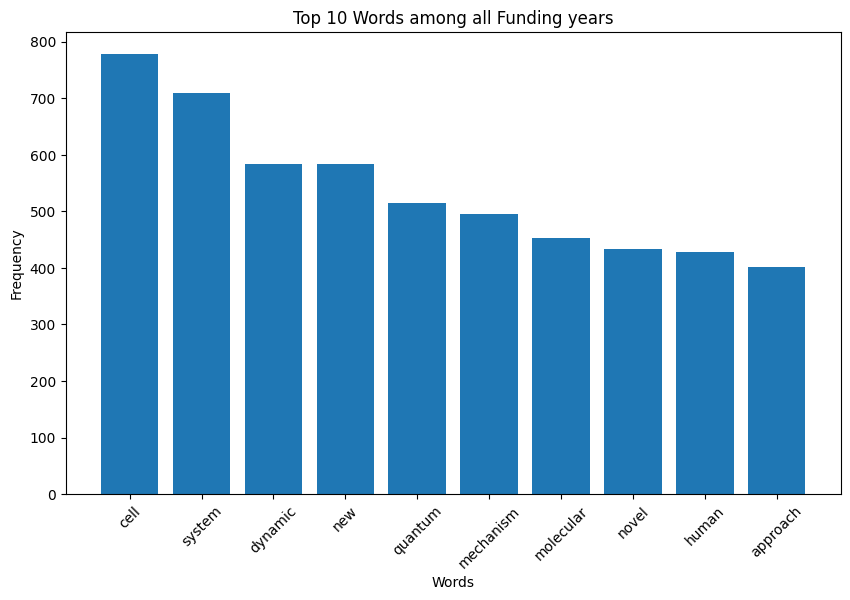

In [ ]:
# Create lists for the words and their frequencies
words = [word for word, count in top_10_words_with_counts]
frequencies = [count for word, count in top_10_words_with_counts]

# Plot the bar graph
plt.figure(figsize=(10, 6))
plt.bar(words, frequencies)
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Top 10 Words among all Funding years')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Initialize a Counter for each funding year
counter_dict = {}

# Iterate over each row in the DataFrame
for index, row in df_selected.iterrows():
    funding_year = row["Year"]
    title = row["Project Title"]

    # Skip if title is None
    if pd.isnull(title):
        continue

    # Tokenize the project title
    tokens = word_tokenize(title.lower())

    # Remove stopwords and non-alphabetic characters
    tokens = [token for token in tokens if token.isalpha() and token not in stop_words]

    # Lemmatize the tokens
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]

    # Update the counter for the specific funding year
    if funding_year not in counter_dict:
        counter_dict[funding_year] = Counter(lemmatized_tokens)
    else:
        counter_dict[funding_year].update(lemmatized_tokens)

# Sort the funding years in ascending order
sorted_funding_years = sorted(counter_dict.keys())

# Find the top 10 most occurring words for each funding year
top_10_words_dict = {}
for funding_year in sorted_funding_years:
    counter = counter_dict[funding_year]
    top_10_words_dict[funding_year] = [word for word, count in counter.most_common(10)]

# Print the top 10 words for each funding year
for funding_year, top_10_words in top_10_words_dict.items():
    print(f"Funding Year: {funding_year}")
    print("Top 10 Words:", top_10_words)
    print()

Funding Year: 2007
Top 10 Words: ['role', 'new', 'cell', 'theory', 'dynamic', 'quantum', 'system', 'mechanism', 'interaction', 'human']

Funding Year: 2008
Top 10 Words: ['system', 'molecular', 'cell', 'new', 'cancer', 'material', 'dynamic', 'biology', 'quantum', 'physic']

Funding Year: 2009
Top 10 Words: ['system', 'cell', 'new', 'mechanism', 'development', 'molecular', 'application', 'human', 'study', 'approach']

Funding Year: 2010
Top 10 Words: ['molecular', 'cell', 'system', 'mechanism', 'dynamic', 'quantum', 'new', 'control', 'human', 'role']

Funding Year: 2011
Top 10 Words: ['system', 'cell', 'dynamic', 'new', 'quantum', 'mechanism', 'theory', 'approach', 'human', 'disease']

Funding Year: 2012
Top 10 Words: ['cell', 'system', 'new', 'molecular', 'dynamic', 'theory', 'mechanism', 'role', 'approach', 'disease']

Funding Year: 2013
Top 10 Words: ['cell', 'system', 'new', 'cancer', 'dynamic', 'novel', 'molecular', 'quantum', 'mechanism', 'imaging']

Funding Year: 2014
Top 10 Word

In [ ]:
# Define the funding year ranges
funding_year_ranges = [
    (2007, 2011),
    (2012, 2015),
    (2016, 2019),
    (2020, 2023)
]

# Initialize a Counter for each funding year range
counter_dict = {range_: Counter() for range_ in funding_year_ranges}

# Iterate over each row in the DataFrame
for index, row in df_selected.iterrows():
    funding_year = row["Year"]
    title = row["Project Title"]

    # Skip if title is None
    if pd.isnull(title):
        continue

    # Tokenize the project title
    tokens = word_tokenize(title.lower())

    # Remove stopwords and non-alphabetic characters
    tokens = [token for token in tokens if token.isalpha() and token not in stop_words]

    # Lemmatize the tokens
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]

    # Update the counter for the corresponding funding year range
    for range_ in funding_year_ranges:
        if range_[0] <= int(funding_year) <= range_[1]:
            counter_dict[range_].update(lemmatized_tokens)
            break

# Find the top 10 most occurring words for each funding year range
top_10_words_dict = {}
for range_, counter in counter_dict.items():
    top_10_words_dict[range_] = [word for word, count in counter.most_common(10)]

# Print the top 10 words for each funding year range
for range_, top_10_words in top_10_words_dict.items():
    print(f"Funding Year Range: {range_[0]} - {range_[1]}")
    print("Top 10 Words:", top_10_words)
    print()

Funding Year Range: 2007 - 2011
Top 10 Words: ['system', 'cell', 'new', 'molecular', 'dynamic', 'mechanism', 'quantum', 'human', 'development', 'approach']

Funding Year Range: 2012 - 2015
Top 10 Words: ['cell', 'system', 'new', 'dynamic', 'quantum', 'molecular', 'approach', 'cancer', 'novel', 'mechanism']

Funding Year Range: 2016 - 2019
Top 10 Words: ['cell', 'system', 'dynamic', 'new', 'mechanism', 'quantum', 'novel', 'development', 'approach', 'material']

Funding Year Range: 2020 - 2023
Top 10 Words: ['cell', 'system', 'quantum', 'dynamic', 'human', 'new', 'mechanism', 'novel', 'material', 'disease']



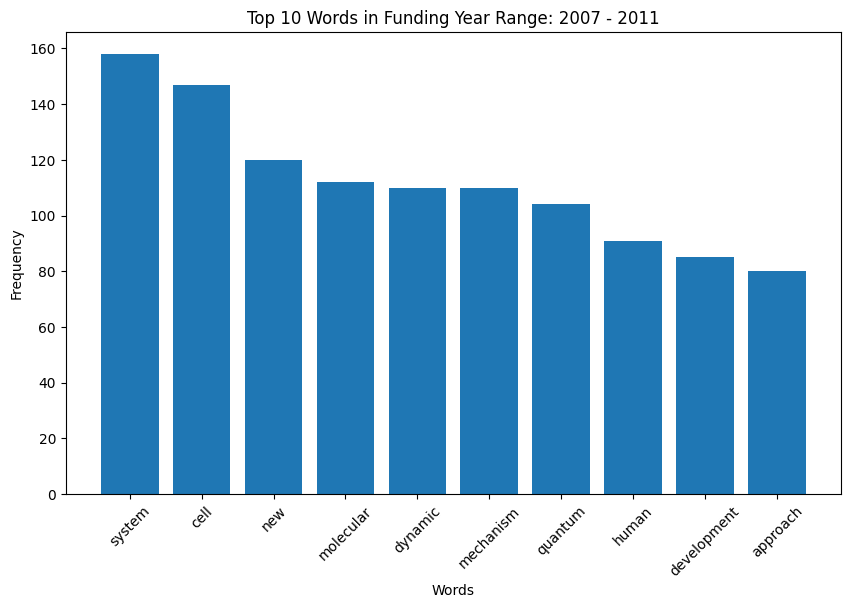

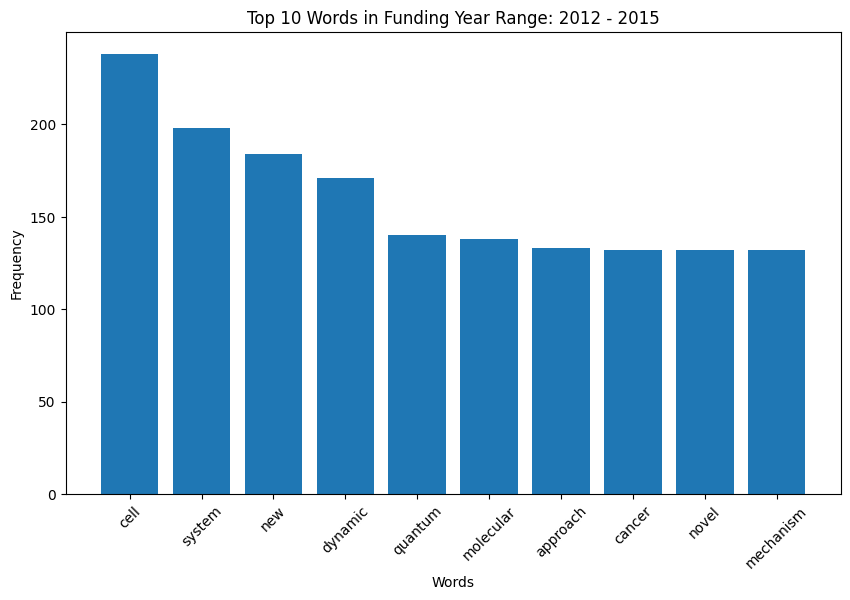

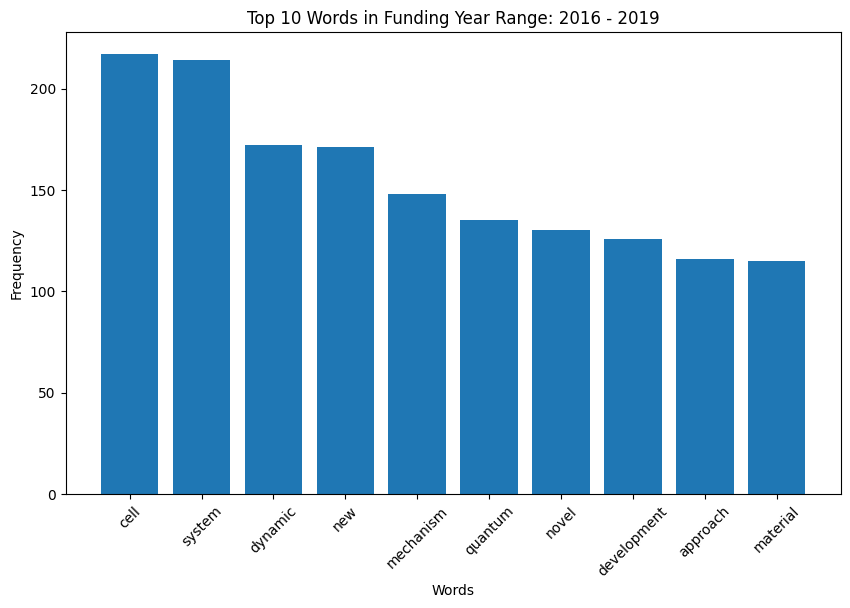

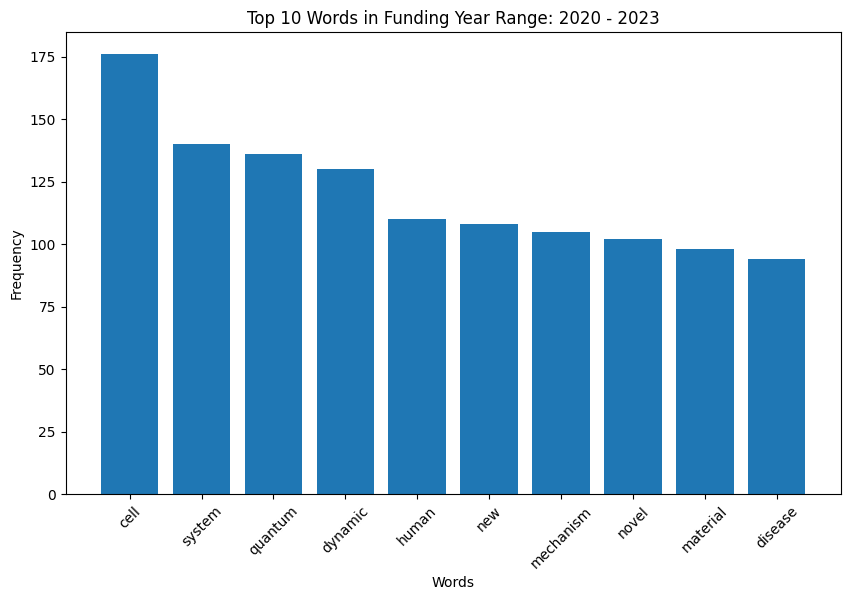

In [ ]:
# Create a list to store the years
years = [f"{range_[0]} - {range_[1]}" for range_ in funding_year_ranges]

# Plotting the graph for each top 10 words in a year range
for range_, top_10_words in top_10_words_dict.items():
    frequencies = [counter_dict[range_][word] for word in top_10_words]
    plt.figure(figsize=(10, 6))
    plt.bar(top_10_words, frequencies)
    plt.ylabel('Frequency')  # Set y-axis label to 'Frequency'
    plt.xlabel('Words')  # Set x-axis label to 'Words'
    plt.title(f'Top 10 Words in Funding Year Range: {range_[0]} - {range_[1]}')
    plt.xticks(rotation=45)
    plt.show()

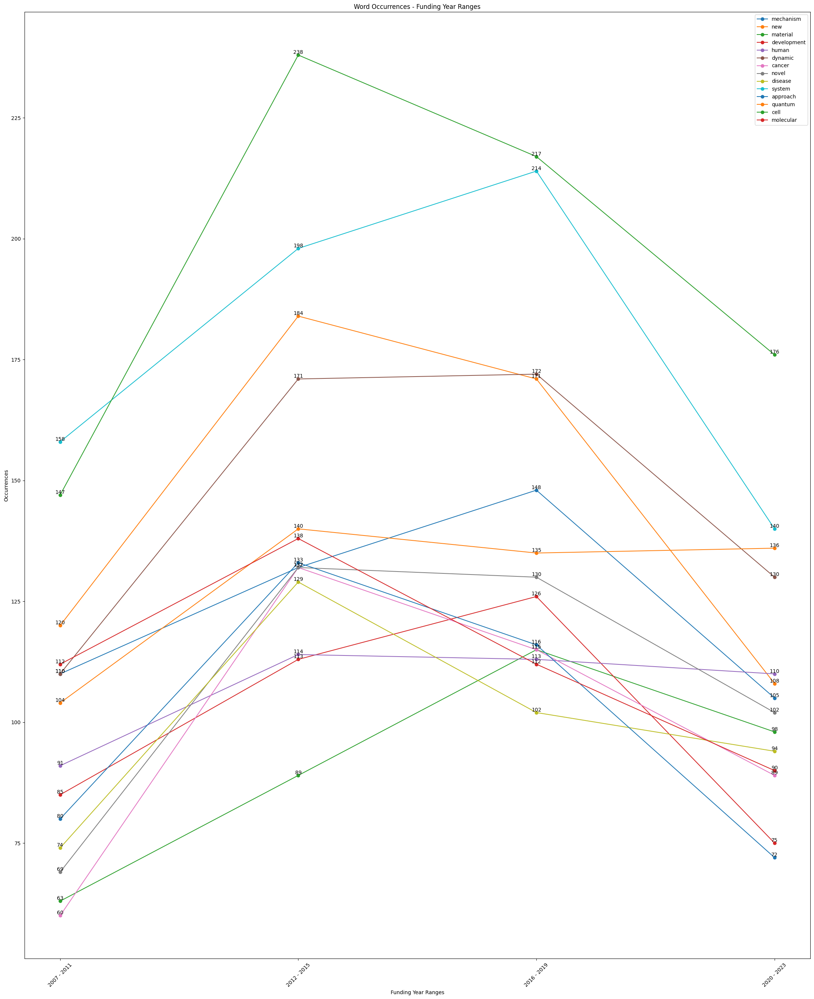

In [ ]:
# Collect the unique words from all funding year ranges
unique_words = set()
for top_10_words in top_10_words_dict.values():
    unique_words.update(top_10_words)

# Prepare the data for the plot
data = []
labels = []

for word in unique_words:
    occurrences = [counter_dict[range_][word] if word in counter_dict[range_] else 0 for range_ in top_10_words_dict.keys()]
    data.append(occurrences)
    labels.append(word)

# Set the x-axis positions for the bars
x = range(len(top_10_words_dict))

# Plot the bars for each word separately
plt.figure(figsize=(22, 27))

for i, word in enumerate(unique_words):
    plt.plot(x, data[i], label=word, marker='o')

    # Add text labels on the graph
    for j, value in enumerate(data[i]):
      plt.text(j, value, value, ha='center', va='bottom')

# Set the title and labels
plt.title("Word Occurrences - Funding Year Ranges")
plt.xlabel("Funding Year Ranges")
plt.ylabel("Occurrences")
plt.xticks(x, [f"{range_[0]} - {range_[1]}" for range_ in top_10_words_dict.keys()], rotation=45)

# Create a legend
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()

Project Abstract Analysis

In [ ]:
# Initialize a Counter for all funding years
counter_all_years = Counter()

# Create a set of stopwords including NLTK stopwords and additional stopwords
stop_words = set(stopwords.words("english"))

# Iterate over each row in the DataFrame
for index, row in df_selected.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

     # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Lemmatize the tokens
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]

    # Remove stopwords and non-alphabetic characters
    filtered_tokens = [token for token in lemmatized_tokens if token.isalpha() and token not in stop_words]

    # Update the counter for all funding years
    counter_all_years.update(filtered_tokens)

# Find the top 100 most common words
top_100_words = [word for word, count in counter_all_years.most_common(100)]

# Print the top 100 words among all Funding years
print("Top 100 Words among all Funding years:", top_100_words)

# Find the top 100 most common words and their counts
top_100_words_with_counts = counter_all_years.most_common(100)

# Print the top 100 words and their counts
for word, count in top_100_words_with_counts:
    print(f"Word: {word}\t\tCount: {count}")

Top 100 Words among all Funding years: ['new', 'project', 'cell', 'system', 'study', 'model', 'research', 'ha', 'approach', 'novel', 'process', 'aim', 'understanding', 'data', 'development', 'mechanism', 'using', 'use', 'develop', 'human', 'method', 'also', 'field', 'material', 'first', 'molecular', 'technology', 'analysis', 'theory', 'quantum', 'application', 'time', 'change', 'interaction', 'structure', 'disease', 'provide', 'different', 'one', 'based', 'dynamic', 'function', 'role', 'property', 'control', 'protein', 'potential', 'however', 'fundamental', 'complex', 'key', 'tool', 'result', 'state', 'technique', 'proposal', 'information', 'two', 'effect', 'question', 'high', 'problem', 'design', 'impact', 'gene', 'network', 'goal', 'work', 'well', 'cancer', 'many', 'used', 'level', 'social', 'current', 'energy', 'challenge', 'propose', 'important', 'large', 'major', 'way', 'developed', 'strategy', 'specific', 'brain', 'within', 'response', 'device', 'thus', 'knowledge', 'identify', '

In [ ]:
# Define additional stopwords to be removed and not counted
additional_stopwords = ["project","analysis","theory","control","potential","however","fundamental","complex","key","tool","result","state","technique","proposal","two","effect","question","high","problem","impact",
                        "goal","work","well","many","used","level","current","challenge","propose","important","large","major","way","developed","strategy","specific","within","response"
                        "thus","knowledge","identify","including","objective","recent","group","activity","unique","new","system","study","model","research","ha","approach","novel",
                        "process","aim","understanding","using","first","use","develop","method","also"]

# Initialize a Counter for all funding years
counter_all_years = Counter()

# Create a set of stopwords including NLTK stopwords and additional stopwords
stop_words = set(stopwords.words("english") + additional_stopwords)

# Iterate over each row in the DataFrame
for index, row in df_selected.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Lemmatize the tokens
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]

    # Remove stopwords and non-alphabetic characters
    filtered_tokens = [token for token in lemmatized_tokens if token.isalpha() and token not in stop_words]

    # Update the counter for all funding years
    counter_all_years.update(filtered_tokens)

# Find the top 10 most common words
top_10_words = [word for word, count in counter_all_years.most_common(10)]

# Print the top 10 words among all Funding years
print("Top 10 Words among all Funding years:", top_10_words)

# Find the top 10 most common words and their counts
top_10_words_with_counts = counter_all_years.most_common(10)

# Print the top 10 words and their counts
for word, count in top_10_words_with_counts:
    print(f"Word: {word}\t\tCount: {count}")

Top 10 Words among all Funding years: ['cell', 'data', 'development', 'mechanism', 'human', 'field', 'material', 'molecular', 'technology', 'quantum']
Word: cell		Count: 13497
Word: data		Count: 6687
Word: development		Count: 6660
Word: mechanism		Count: 6279
Word: human		Count: 6030
Word: field		Count: 5646
Word: material		Count: 5629
Word: molecular		Count: 5299
Word: technology		Count: 5261
Word: quantum		Count: 5078


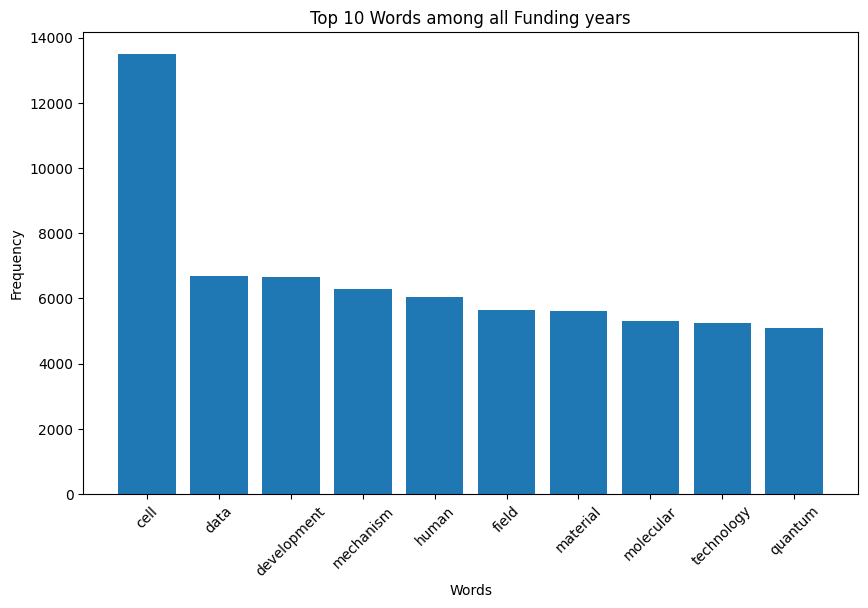

In [ ]:
# Create lists for the words and their frequencies
words = [word for word, count in top_10_words_with_counts]
frequencies = [count for word, count in top_10_words_with_counts]

# Plot the bar graph
plt.figure(figsize=(10, 6))
plt.bar(words, frequencies)
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Top 10 Words among all Funding years')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Initialize a Counter for each funding year
counter_dict = {}

# Iterate over each row in the DataFrame
for index, row in df_selected.iterrows():
    funding_year = row["Year"]
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the project abstract
    tokens = word_tokenize(abstract.lower())

    # Remove stopwords and non-alphabetic characters
    tokens = [token for token in tokens if token.isalpha() and token not in stop_words]

    # Lemmatize the tokens
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]

    # Update the counter for the specific funding year
    if funding_year not in counter_dict:
        counter_dict[funding_year] = Counter(lemmatized_tokens)
    else:
        counter_dict[funding_year].update(lemmatized_tokens)

# Sort the funding years in ascending order
sorted_funding_years = sorted(counter_dict.keys())

# Find the top 10 most occurring words for each funding year
top_10_words_dict = {}
for funding_year in sorted_funding_years:
    counter = counter_dict[funding_year]
    top_10_words_dict[funding_year] = [word for word, count in counter.most_common(10)]

# Print the top 10 words for each funding year
for funding_year, top_10_words in top_10_words_dict.items():
    print(f"Funding Year: {funding_year}")
    print("Top 10 Words:", top_10_words)
    print()

Funding Year: 2007
Top 10 Words: ['cell', 'mechanism', 'development', 'molecular', 'model', 'protein', 'gene', 'one', 'different', 'role']

Funding Year: 2008
Top 10 Words: ['cell', 'system', 'human', 'molecular', 'application', 'development', 'quantum', 'model', 'field', 'mechanism']

Funding Year: 2009
Top 10 Words: ['cell', 'system', 'development', 'molecular', 'model', 'field', 'mechanism', 'gene', 'structure', 'data']

Funding Year: 2010
Top 10 Words: ['cell', 'mechanism', 'human', 'system', 'molecular', 'structure', 'development', 'data', 'process', 'field']

Funding Year: 2011
Top 10 Words: ['cell', 'system', 'mechanism', 'development', 'molecular', 'application', 'material', 'field', 'structure', 'protein']

Funding Year: 2012
Top 10 Words: ['cell', 'mechanism', 'development', 'molecular', 'model', 'system', 'function', 'interaction', 'human', 'disease']

Funding Year: 2013
Top 10 Words: ['cell', 'development', 'mechanism', 'field', 'model', 'protein', 'molecular', 'function', 

In [ ]:
# Define the funding year ranges
funding_year_ranges = [
    (2007, 2011),
    (2012, 2015),
    (2016, 2019),
    (2020, 2023)
]

# Initialize a Counter for each funding year range
counter_dict = {range_: Counter() for range_ in funding_year_ranges}

# Iterate over each row in the DataFrame
for index, row in df_selected.iterrows():
    funding_year = row["Year"]
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the project abstract
    tokens = word_tokenize(abstract.lower())

    # Remove stopwords and non-alphabetic characters
    tokens = [token for token in tokens if token.isalpha() and token not in stop_words]

    # Lemmatize the tokens
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]

    # Update the counter for the corresponding funding year range
    for range_ in funding_year_ranges:
        if range_[0] <= int(funding_year) <= range_[1]:
            counter_dict[range_].update(lemmatized_tokens)
            break

# Find the top 10 most occurring words for each funding year range
top_10_words_dict = {}
for range_, counter in counter_dict.items():
    top_10_words_dict[range_] = [word for word, count in counter.most_common(10)]

# Print the top 10 words for each funding year range
for range_, top_10_words in top_10_words_dict.items():
    print(f"Funding Year Range: {range_[0]} - {range_[1]}")
    print("Top 10 Words:", top_10_words)
    print()

Funding Year Range: 2007 - 2011
Top 10 Words: ['cell', 'system', 'mechanism', 'development', 'molecular', 'structure', 'human', 'field', 'model', 'gene']

Funding Year Range: 2012 - 2015
Top 10 Words: ['cell', 'development', 'mechanism', 'system', 'data', 'molecular', 'field', 'human', 'model', 'application']

Funding Year Range: 2016 - 2019
Top 10 Words: ['cell', 'data', 'development', 'human', 'system', 'mechanism', 'material', 'technology', 'model', 'field']

Funding Year Range: 2020 - 2023
Top 10 Words: ['cell', 'data', 'material', 'system', 'human', 'technology', 'development', 'mechanism', 'quantum', 'change']



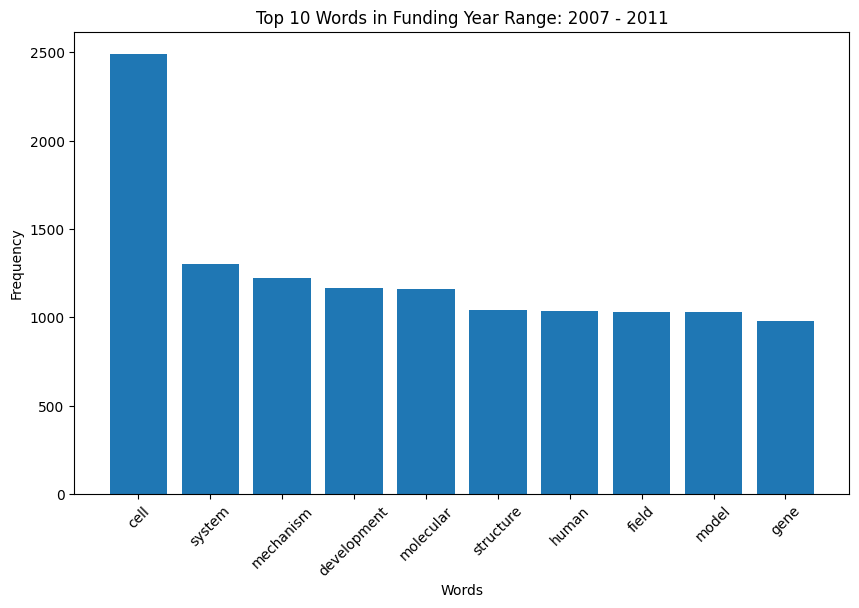

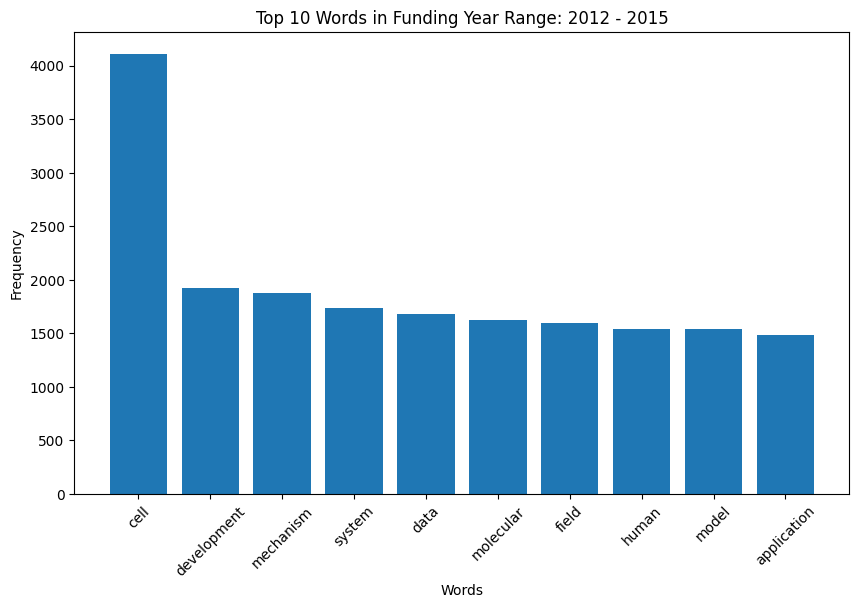

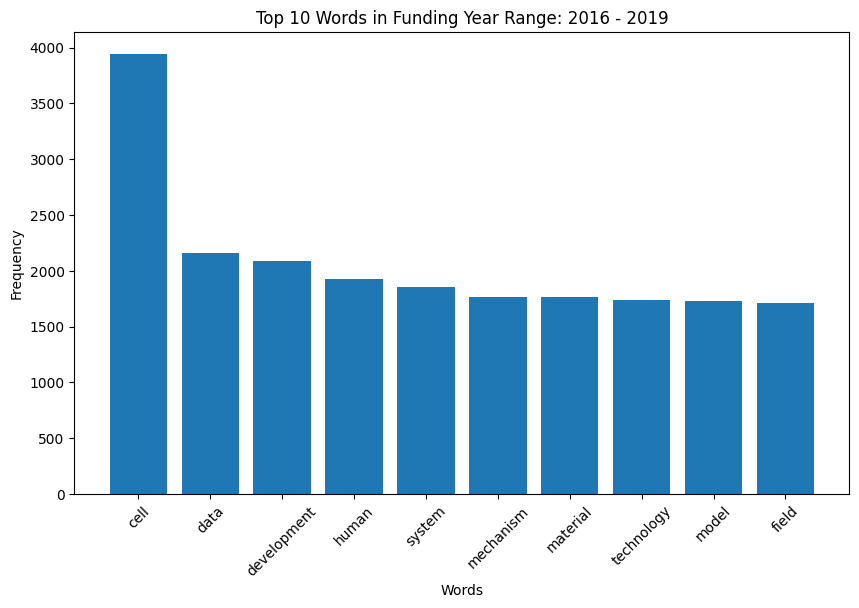

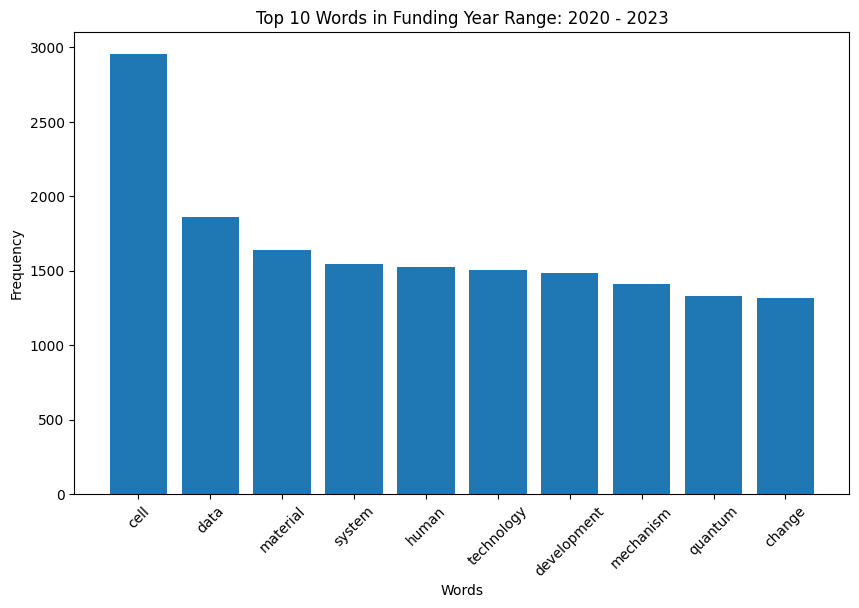

In [ ]:
# Create a list to store the years
years = [f"{range_[0]} - {range_[1]}" for range_ in funding_year_ranges]

# Plotting the graph for each top 10 words in a year range
for range_, top_10_words in top_10_words_dict.items():
    frequencies = [counter_dict[range_][word] for word in top_10_words]
    plt.figure(figsize=(10, 6))
    plt.bar(top_10_words, frequencies)
    plt.ylabel('Frequency')  # Set y-axis label to 'Frequency'
    plt.xlabel('Words')  # Set x-axis label to 'Words'
    plt.title(f'Top 10 Words in Funding Year Range: {range_[0]} - {range_[1]}')
    plt.xticks(rotation=45)
    plt.show()

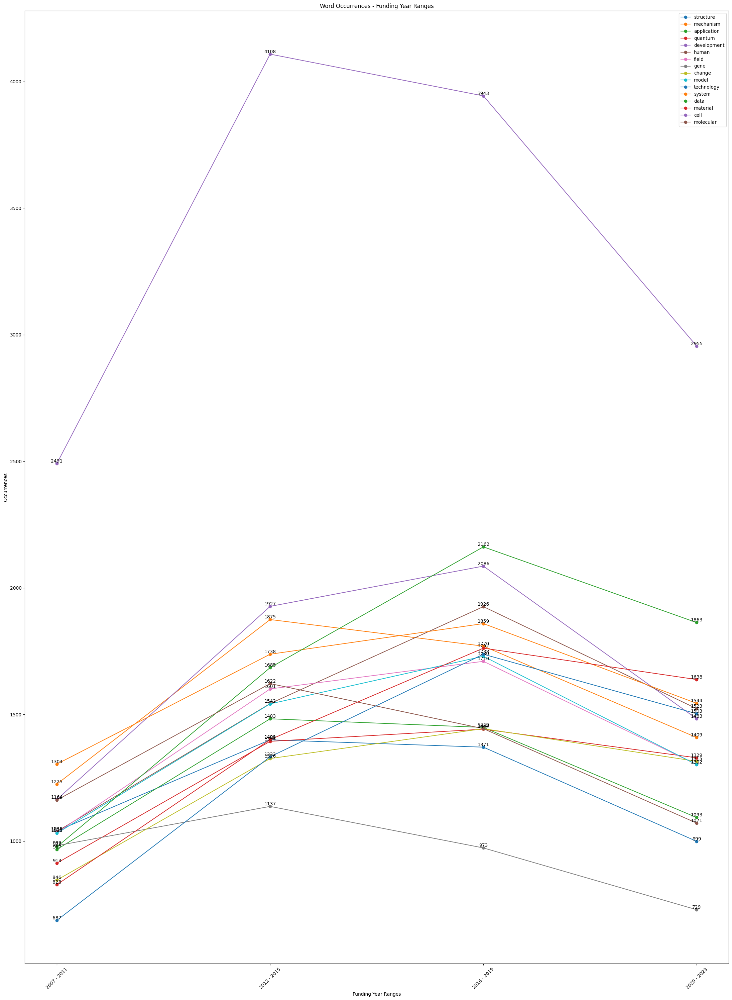

In [ ]:
# Collect the unique words from all funding year ranges
unique_words = set()
for top_10_words in top_10_words_dict.values():
    unique_words.update(top_10_words)

# Prepare the data for the plot
data = []
labels = []

for word in unique_words:
    occurrences = [counter_dict[range_][word] if word in counter_dict[range_] else 0 for range_ in top_10_words_dict.keys()]
    data.append(occurrences)
    labels.append(word)

# Set the x-axis positions for the bars
x = range(len(top_10_words_dict))

# Plot the bars for each word separately
plt.figure(figsize=(22, 30))

for i, word in enumerate(unique_words):
    plt.plot(x, data[i], label=word, marker='o')

    # Add text labels on the graph
    for j, value in enumerate(data[i]):
      plt.text(j, value, value, ha='center', va='bottom')

# Set the title and labels
plt.title("Word Occurrences - Funding Year Ranges")
plt.xlabel("Funding Year Ranges")
plt.ylabel("Occurrences")
plt.xticks(x, [f"{range_[0]} - {range_[1]}" for range_ in top_10_words_dict.keys()], rotation=45)

# Create a legend
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()


Disease Analysis

In [ ]:
df_selected

,Project Title,_abstract,Year
0,Actively learning experimental designs in terr...,"While land-atmosphere exchanges of carbon, wat...",2023
1,Protecting the planet’s bloodstream: feasible ...,Freshwater has a fundamental role in regulatin...,2023
2,Chemical Transformations in the Inter-Stellar ...,"Until the beginning of the last century, the s...",2023
3,Practical magnesium batteries enabled by 2D cr...,The intrinsic limitation of Li-ion batteries (...,2023
4,Artificial Catalysts for Endergonic Reduction ...,Endergonic catalysis converts low-energy subst...,2023
...,...,...,...
14756,New Adaptive Computational Methods for Fluid-S...,For many problems involving a fluid and a stru...,2007
14757,Uncovering the Secrets of an Earthquake: Multi...,Understanding the physico-chemical processes c...,2007
14758,"Vectorial Elliptic, Parabolic and Variational ...",The aim of the proposed project is to start a ...,2007
14759,"Von Neumann algebras, group actions and discre...","Von Neumann algebras, and more specifically II...",2007


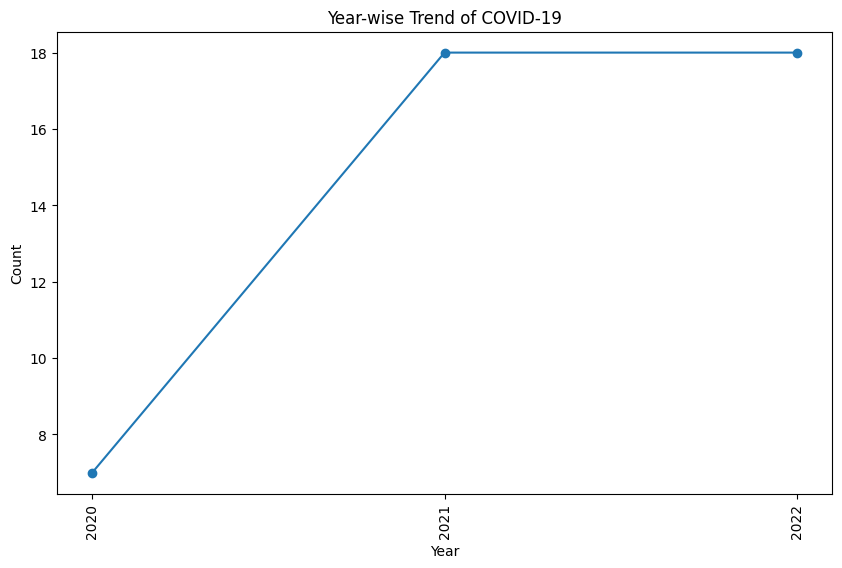

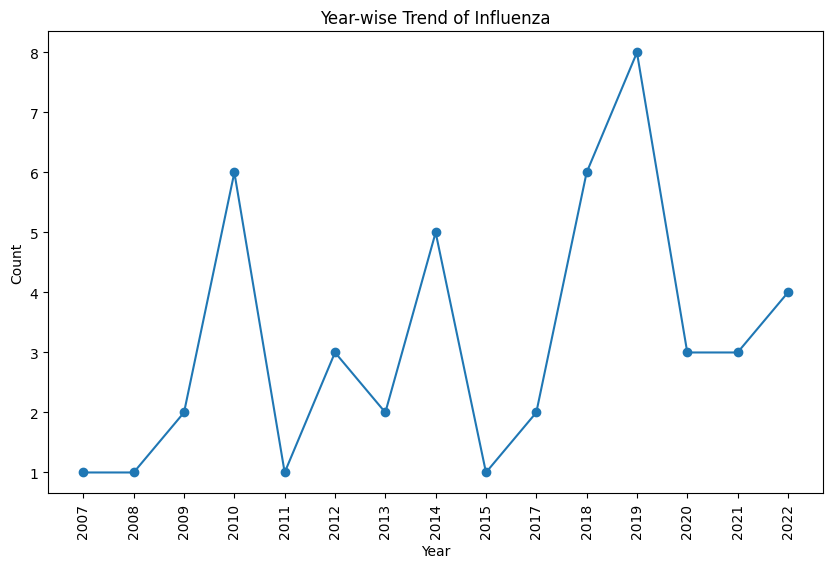

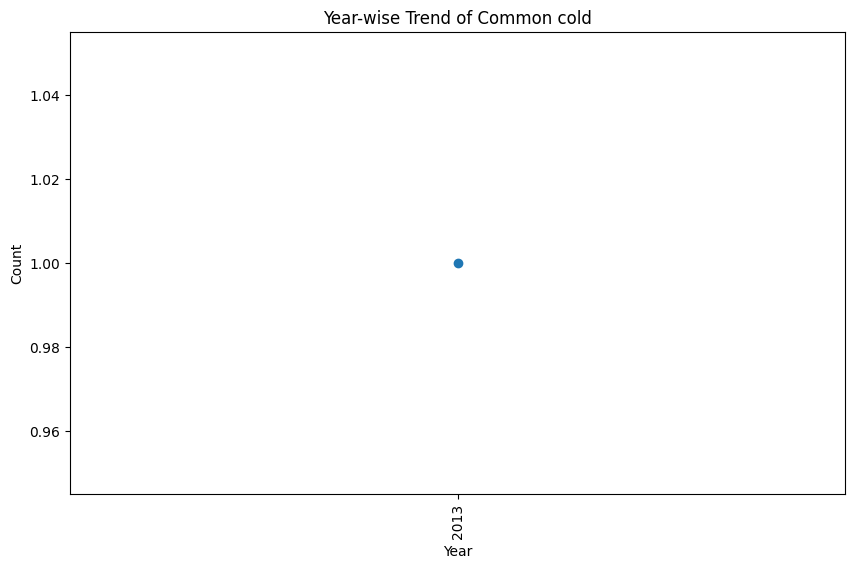

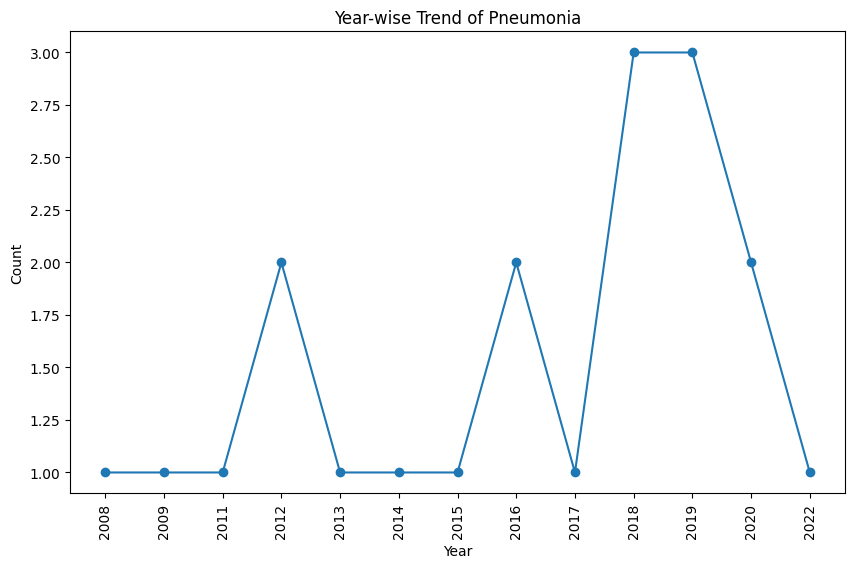

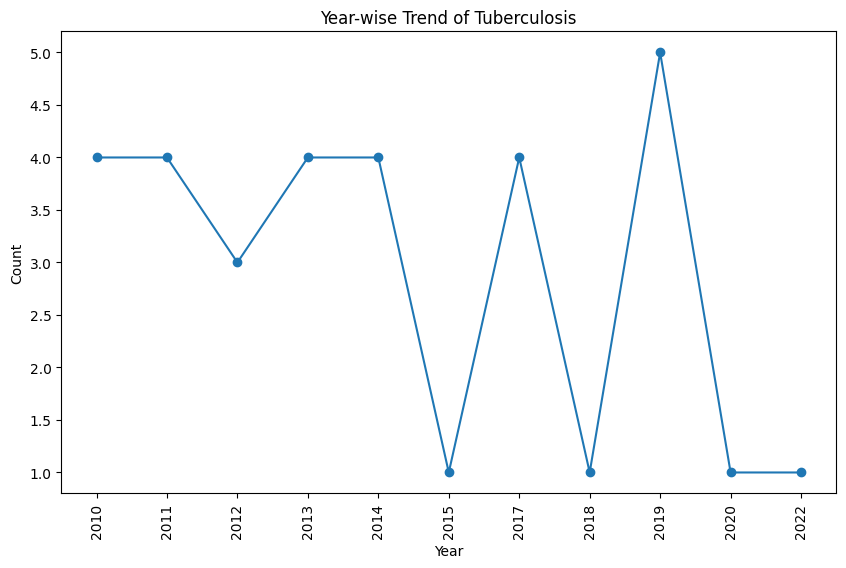

...

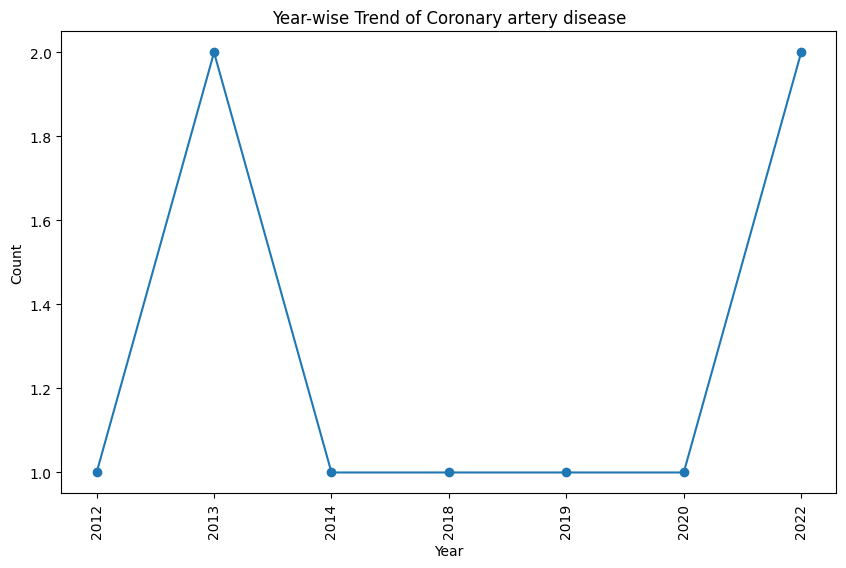

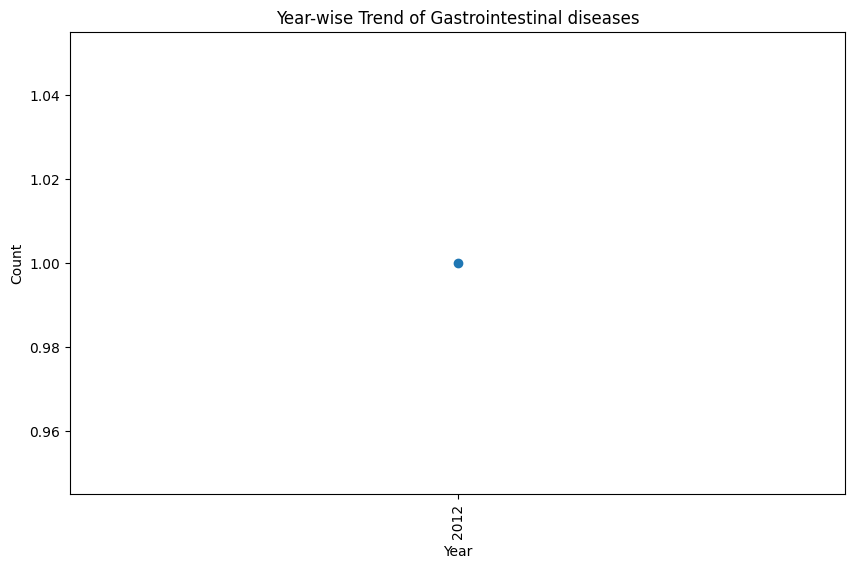

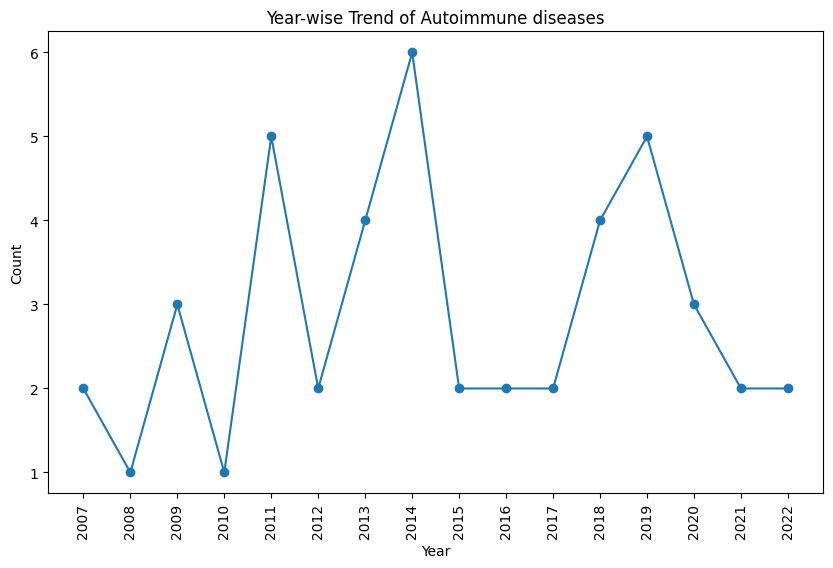

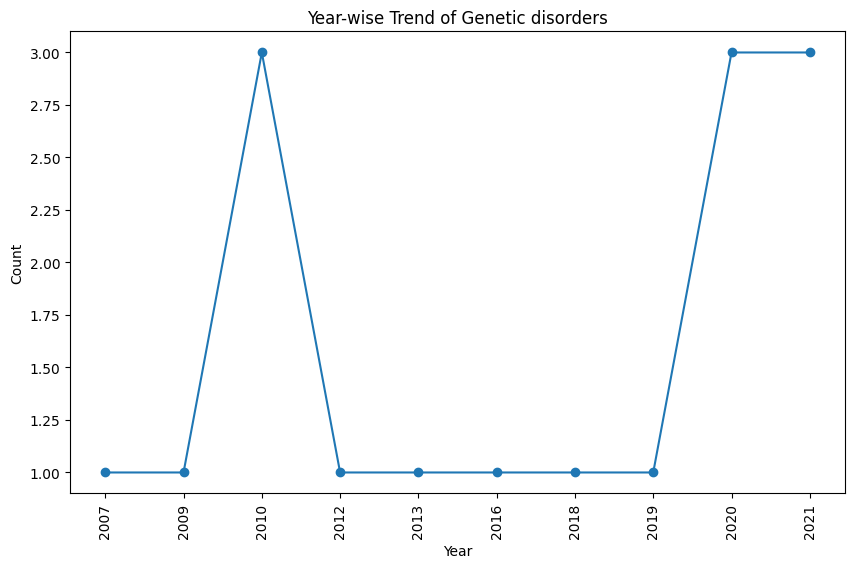

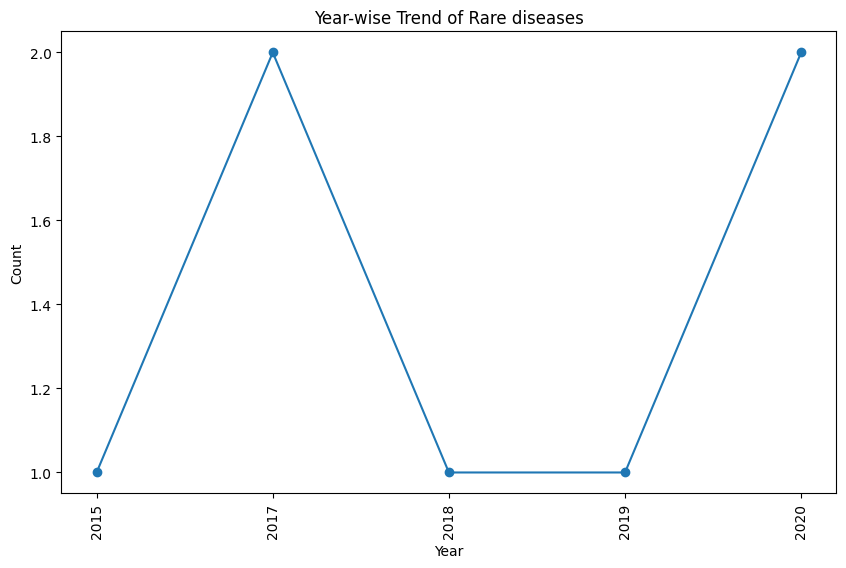

In [ ]:
# Importing the necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
from collections import defaultdict

# Load the DataFrame
df = df_selected

# Define the diseases of interest
diseases = [
    "COVID-19",
    "Influenza",
    "Common cold",
    "Pneumonia",
    "Tuberculosis",
    "HIV/AIDS",
    "Malaria",
    "Dengue fever",
    "Cholera",
    "Ebola",
    "Zika virus",
    "Measles",
    "Polio",
    "Hepatitis",
    "Diabetes",
    "Cancer",
    "Heart disease",
    "Stroke",
    "Alzheimer's disease",
    "Parkinson's disease",
    "Multiple sclerosis",
    "Rheumatoid arthritis",
    "Osteoarthritis",
    "Epilepsy",
    "Schizophrenia",
    "Depression",
    "Anxiety disorders",
    "Bipolar disorder",
    "Autism spectrum disorders",
    "Attention deficit hyperactivity disorder (ADHD)",
    "Asthma",
    "Chronic obstructive pulmonary disease (COPD)",
    "Kidney disease",
    "Liver disease",
    "Obesity",
    "Anemia",
    "Hypertension",
    "Coronary artery disease",
    "Gastrointestinal diseases",
    "Autoimmune diseases",
    "Genetic disorders",
    "Rare diseases"
]

# Initialize a dictionary to store the year-wise counts of diseases
yearly_counts = defaultdict(lambda: defaultdict(int))

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    title = row["Project Title"]
    abstract = row["_abstract"]
    year = row["Year"]

    # Check for missing values in title and abstract
    if pd.isnull(title) or pd.isnull(abstract):
        continue

    # Check if the title or abstract contains any of the diseases
    for disease in diseases:
        if disease.lower() in title.lower() or disease.lower() in abstract.lower():
            yearly_counts[disease][year] += 1

# Plot the year-wise trends for each disease
for disease in diseases:
    plt.figure(figsize=(10, 6))
    sorted_counts = sorted(yearly_counts[disease].items())
    years = [year for year, count in sorted_counts]
    counts = [count for year, count in sorted_counts]
    plt.plot(years, counts, marker='o')
    plt.xlabel('Year')
    plt.ylabel('Count')
    plt.title(f'Year-wise Trend of {disease}')
    plt.xticks(rotation=90)
    plt.show()


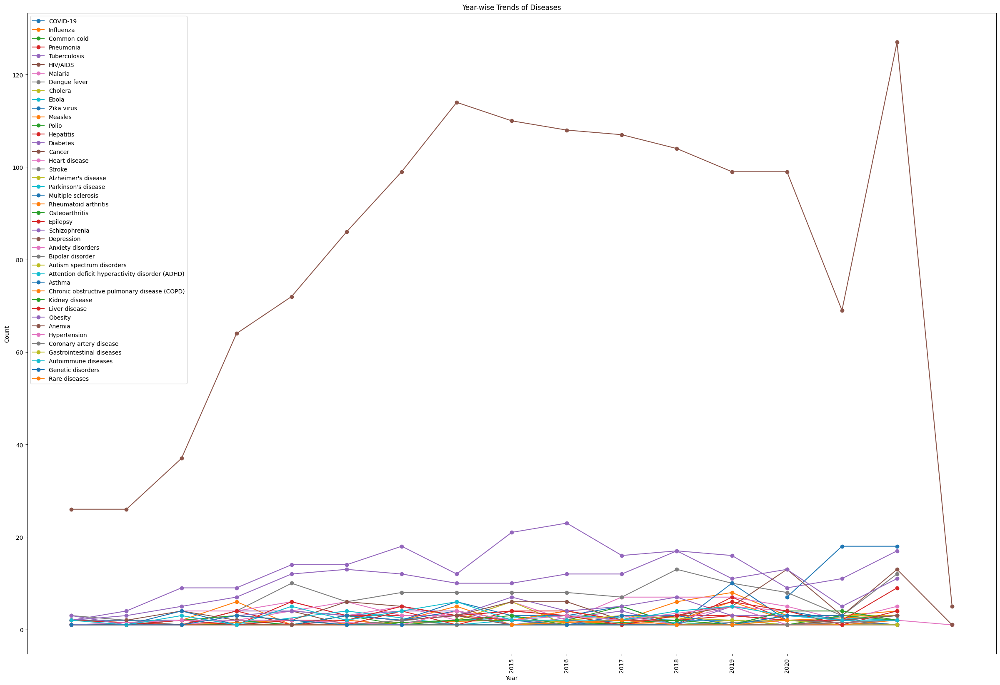

In [ ]:
# Load the DataFrame
df = df_selected

# Initialize a dictionary to store the year-wise counts of diseases
yearly_counts = defaultdict(lambda: defaultdict(int))

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    title = row["Project Title"]
    abstract = row["_abstract"]
    year = row["Year"]

    # Check for missing values in title and abstract
    if pd.isnull(title) or pd.isnull(abstract):
        continue

    # Check if the title or abstract contains any of the diseases
    for disease in diseases:
        if disease.lower() in title.lower() or disease.lower() in abstract.lower():
            yearly_counts[disease][int(year)] += 1

# Plot the year-wise trends for each disease
plt.figure(figsize=(30, 20))

for disease in diseases:
    sorted_counts = sorted(yearly_counts[disease].items(), key=lambda x: x[0])
    years = [year for year, count in sorted_counts]
    counts = [count for year, count in sorted_counts]
    plt.plot(years, counts, marker='o', label=disease)

plt.xlabel('Year')
plt.ylabel('Count')
plt.title('Year-wise Trends of Diseases')
plt.xticks(rotation=90)
plt.xticks(range(min(years), max(years) + 1))
plt.legend()
plt.show()

Finding a word before and after the words: 'disease', 'virus' and 'infection'

In [ ]:
# Import string to find out a word before and after the words: 'disease', 'virus' and 'infection'
import string

# Load the DataFrame
df = df_selected

# Initialize a dictionary to store the year-wise counts of diseases
yearly_counts = defaultdict(lambda: defaultdict(int))

# Initialize dictionaries to store the relevant words
before_disease_words = defaultdict(set)
before_virus_words = defaultdict(set)
before_infection_words = defaultdict(set)
after_disease_words = defaultdict(set)
after_virus_words = defaultdict(set)
after_infection_words = defaultdict(set)

# Define stopwords
stop_words = set(stopwords.words("english"))

# Exclude punctuation marks from the stopwords
stop_words = stop_words.union(set(string.punctuation))

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    title = row["Project Title"]
    abstract = row["_abstract"]
    year = row["Year"]

    # Check for missing values in title and abstract
    if pd.isnull(title) or pd.isnull(abstract):
        continue

    # Tokenize the abstract
    abstract_tokens = word_tokenize(abstract.lower())

    # Find words before and after 'disease', 'virus', and 'infection'
    for i in range(1, len(abstract_tokens)):
        if abstract_tokens[i].lower() == 'disease':
            for j in range(i - 1, max(i - 11, -1), -1):
                if abstract_tokens[j].lower() not in stop_words:
                    before_disease_words[year].add(abstract_tokens[j])
                    break
            for k in range(i + 1, min(i + 11, len(abstract_tokens))):
                if abstract_tokens[k].lower() not in stop_words:
                    after_disease_words[year].add(abstract_tokens[k])
                    break
            break

        elif abstract_tokens[i].lower() == 'virus':
            for j in range(i - 1, max(i - 11, -1), -1):
                if abstract_tokens[j].lower() not in stop_words:
                    before_virus_words[year].add(abstract_tokens[j])
                    break
            for k in range(i + 1, min(i + 11, len(abstract_tokens))):
                if abstract_tokens[k].lower() not in stop_words:
                    after_virus_words[year].add(abstract_tokens[k])
                    break
            break

        elif abstract_tokens[i].lower() == 'infection':
            for j in range(i - 1, max(i - 11, -1), -1):
                if abstract_tokens[j].lower() not in stop_words:
                    before_infection_words[year].add(abstract_tokens[j])
                    break
            for k in range(i + 1, min(i + 11, len(abstract_tokens))):
                if abstract_tokens[k].lower() not in stop_words:
                    after_infection_words[year].add(abstract_tokens[k])
                    break
            break

# Print the relevant words before 'disease'
print("Words before 'disease':")
for year, words in before_disease_words.items():
    print(f"Year: {year}\tWords: {words}")

# Print the relevant words before 'virus'
print("\nWords before 'virus':")
for year, words in before_virus_words.items():
    print(f"Year: {year}\tWords: {words}")

# Print the relevant words before 'infection'
print("\nWords before 'infection':")
for year, words in before_infection_words.items():
    print(f"Year: {year}\tWords: {words}")

# Print the relevant words after 'disease'
print("\nWords after 'disease':")
for year, words in after_disease_words.items():
    print(f"Year: {year}\tWords: {words}")

# Print the relevant words after 'virus'
print("\nWords after 'virus':")
for year, words in after_virus_words.items():
    print(f"Year: {year}\tWords: {words}")

# Print the relevant words after 'infection'
print("\nWords after 'infection':")
for year, words in after_infection_words.items():
    print(f"Year: {year}\tWords: {words}")

Words before 'disease':
Year: 2023	Words: {'relapsed', '’', 'heart', 'severe'}
Year: 2022	Words: {'interactions', 'exacerbate', 'rate', 'aging', 'parasitic', 'evolution', 'devastating', 'based', 'kidney', 'life-threatening', 'pulmonary', 'important', 'conditions', 'medicine', 'fatal', '30', 'aml', 'progression', 'irrespective', 'strategy', 'lung', 'promote', 'social', 'production', 'worse', 'imbalances', 'undiscovered', 'powerful', 'drought', 'human', 'dysregulated', 'homeostasis', 'metastatic', 'aggressive', 'monitoring', 'studies', 'prototypical', 'avenues', 'intra-abdominal', 'common', 'development', 'preclinical', 'neuroinflammation', 'cancer', 'artery', 'direct', 'bowel', 'normal', 'infiltration', 'crop', 'known', 'force', 'causes', 'alleviate', 'fully', 'hypothalamic', 'adapted', 'variability', 'graft-versus-host', 'chronic', 'contributes', 'range', 'understanding', 'determines', 'years', 'similar', 'plant', 'causing', 'liver', 'leads', 'succumb', 'roots', 'cmt', 'gastrointestina

Knowledge Graph

In [ ]:
# Load the DataFrame
df = df_selected

# Define stopwords
stop_words = set(stopwords.words("english"))
stop_words = stop_words.union(set(string.punctuation))

# Initialize a dictionary to store relationships
knowledge_graph = {}

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Extract relationships based on keywords
    for i, token in enumerate(tokens):
        if token == 'disease':
            for j in range(i - 10, i + 11):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    if token not in knowledge_graph:
                        knowledge_graph[token] = set()
                    knowledge_graph[token].add(tokens[j])
        elif token == 'virus' or token == 'infection':
            for j in range(i - 10, i + 11):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    if token not in knowledge_graph:
                        knowledge_graph[token] = set()
                    knowledge_graph[token].add(tokens[j])

# Print the knowledge graph
for entity, related_entities in knowledge_graph.items():
    print(f"{entity}: {', '.join(related_entities)}")

disease: smut, biomolecular, used, scolistorm, lesion, attain, retinoic, stressors, wishing, apply, genotype-immunotype, deemed, 3, bears, cutting-edge, stomatin-like, presbyopia, bradycardia, intergenic, neurovascular, reduced, cure, translates, cellular, delivery, 85, rhabdoid, 44, shortcomings, compound, systematically, unmatched, activity-, exert, define, contrast, consists, citizen, cancer, wild, stem-like, hurdles, arthropod, testbeds, considering, paramount, goals, clarification, nos, intensified, significance, temperature, back, poses, omic, security, notable, unfortunately, nutrient, replace, background, abilities, host, romb, materialize, propagation, great, vitro/blood-based, unparalleled, focussing, manipulations, 70, il-10, hb-egf, airway, drivers, valve, placental, swedish, built, establishing, envenoming, developments, usa, web-based, residence, mmr, biotargeting, incomplete, pressing, tumor, evolve, cll, summary, non-communicable, bouts, impose, 1-42, analytical, resist

In [ ]:
# This code will extract and print relationships between keywords (like "disease", "virus", "infection") and other relevant words occurring within 10 words before or after
# the keyword in the abstracts. This is a simplified approach and won't produce a comprehensive knowledge graph, but it's a starting point. To build a more robust knowledge graph, we need
# more advanced techniques like named entity recognition, relationship extraction, and potentially external ontologies or knowledge bases.

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 61538 (\uf062) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 61537 (\uf061) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


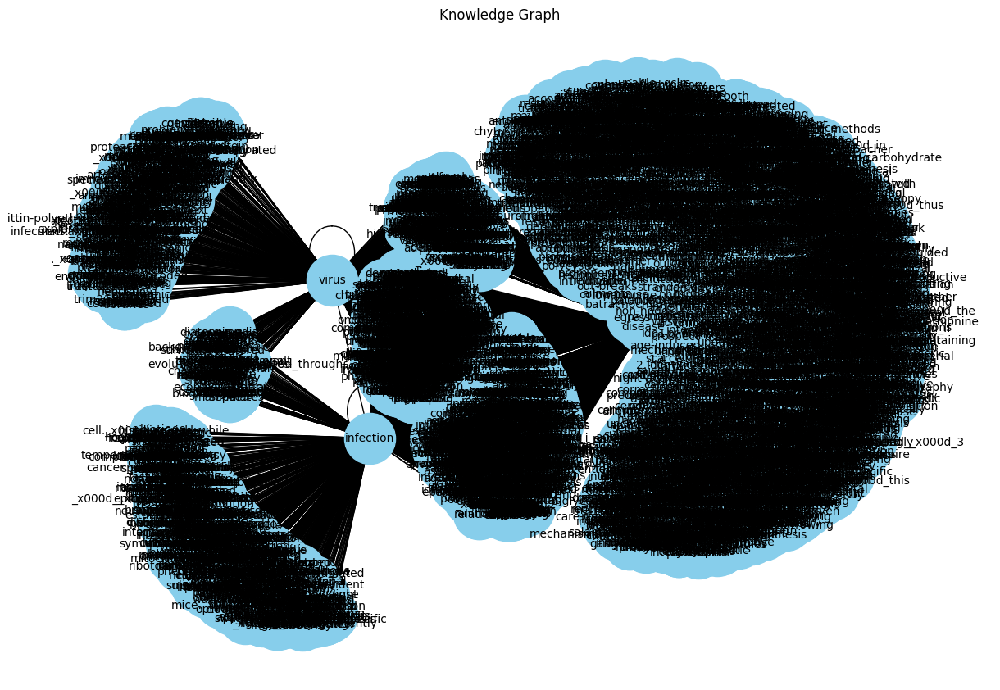

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string

# Load the DataFrame
df = df_selected

# Define stopwords
stop_words = set(stopwords.words("english"))
stop_words = stop_words.union(set(string.punctuation))

# Initialize a graph
G = nx.Graph()

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Extract relationships based on keywords
    for i, token in enumerate(tokens):
        if token == 'disease':
            for j in range(i - 10, i + 11):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])
        elif token == 'virus' or token == 'infection':
            for j in range(i - 10, i + 11):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])

# Plot the knowledge graph
pos = nx.spring_layout(G, seed=42)  # Layout for visualization
plt.figure(figsize=(12, 8))
nx.draw(G, pos, with_labels=True, font_size=10, node_size=2000, node_color='skyblue')
plt.title("Knowledge Graph")
plt.show()


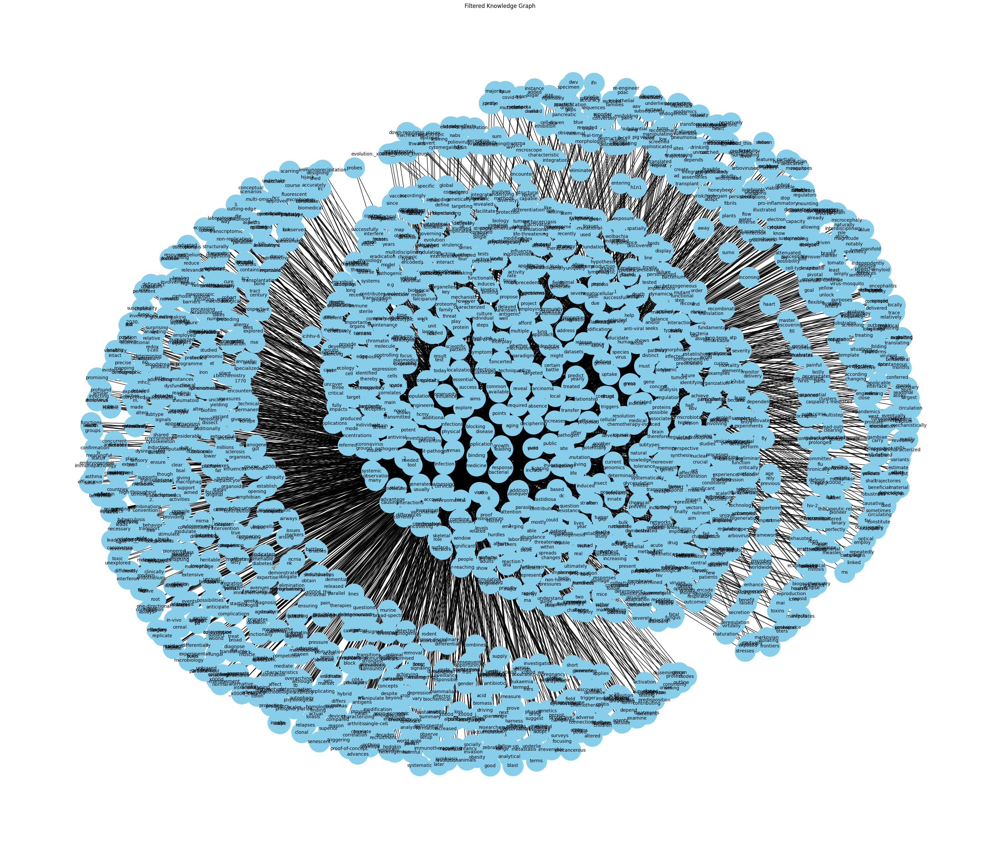

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string

# Load the DataFrame
df = df_selected

# Define stopwords
stop_words = set(stopwords.words("english"))
stop_words = stop_words.union(set(string.punctuation))

# Initialize a graph
G = nx.Graph()

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Extract relationships based on keywords
    for i, token in enumerate(tokens):
        if token == 'disease':
            for j in range(i - 10, i + 11):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])
        elif token == 'virus' or token == 'infection':
            for j in range(i - 10, i + 11):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])

# Filter nodes with degree > 1
filtered_nodes = [node for node in G.nodes if G.degree[node] > 1]

# Create a subgraph with filtered nodes
H = G.subgraph(filtered_nodes)

# Plot the knowledge graph
pos = nx.spring_layout(H, seed=42)  # Layout for visualization
plt.figure(figsize=(30, 25))
nx.draw(H, pos, with_labels=True, font_size=10, node_size=2000, node_color='skyblue')
plt.title("Filtered Knowledge Graph")
plt.show()


In [ ]:
# This code filters nodes with degree greater than 1, which means nodes that are connected to more than one other node.
# This helps in reducing the density of the graph and focusing on the more important relationships.

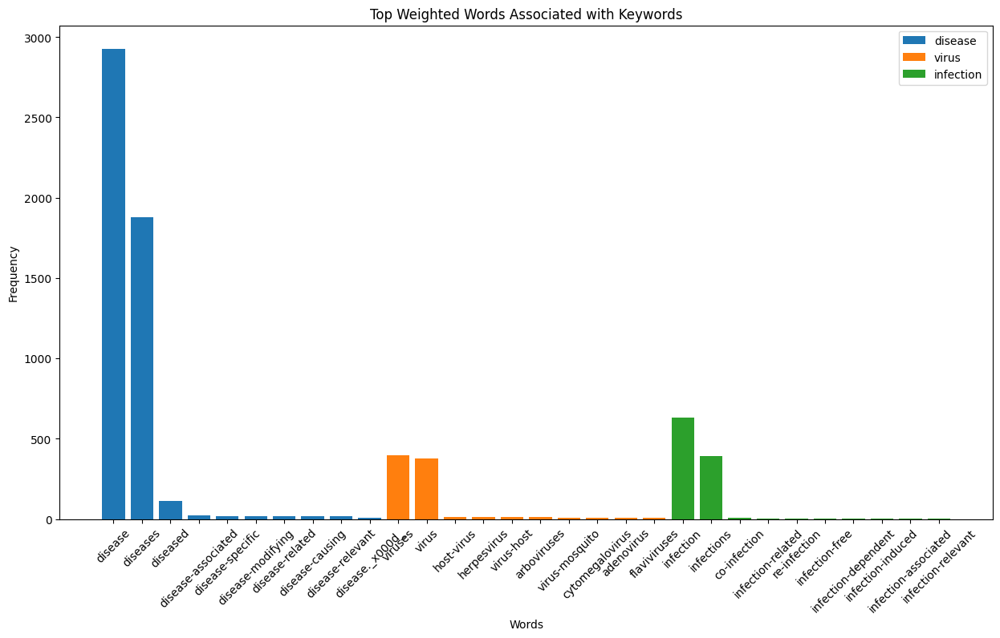

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string
from collections import defaultdict

# Load the DataFrame
df = df_selected

# Define stopwords
stop_words = set(stopwords.words("english"))
stop_words = stop_words.union(set(string.punctuation))

# Initialize a dictionary to store word frequencies
word_frequencies = defaultdict(int)

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Count word frequencies
    for token in tokens:
        if token not in stop_words:
            word_frequencies[token] += 1

# Define keywords of interest
keywords = ['disease', 'virus', 'infection']

# Calculate weights based on word frequencies
weights = {keyword: {word: freq for word, freq in word_frequencies.items() if keyword in word} for keyword in keywords}

# Plot the weighted words for each keyword
plt.figure(figsize=(15, 8))

for keyword in keywords:
    top_words = sorted(weights[keyword].items(), key=lambda x: x[1], reverse=True)[:10]
    words, freqs = zip(*top_words)
    plt.bar(words, freqs, label=keyword)

plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Top Weighted Words Associated with Keywords')
plt.xticks(rotation=45)
plt.legend()
plt.show()


In [ ]:
# This code calculates the frequencies of words associated with each keyword, assigns weights based on the frequencies,
# and then plots the top weighted words for each keyword.

In [ ]:
# Drawing Knowledge graph using 5 words before and after

In [ ]:
# Initialize a dictionary to store relationships
knowledge_graph = {}

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Extract relationships based on keywords
    for i, token in enumerate(tokens):
        if token == 'disease':
            for j in range(i - 5, i + 6):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    if token not in knowledge_graph:
                        knowledge_graph[token] = set()
                    knowledge_graph[token].add(tokens[j])
        elif token == 'virus' or token == 'infection':
            for j in range(i - 5, i + 6):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    if token not in knowledge_graph:
                        knowledge_graph[token] = set()
                    knowledge_graph[token].add(tokens[j])

# Print the knowledge graph
for entity, related_entities in knowledge_graph.items():
    print(f"{entity}: {', '.join(related_entities)}")

disease: smut, used, tractability, aggravation, scolistorm, condition, popular, challenges, alzheimeralzheimer, tuberculosis, pre, egfr+, malignant, systemic, kidney, elucidation, apply, milieu, stressors, postmortem, autoantibodies, conditions, researchers, photoreceptor, susceptibility/prognosis._x000d_, doctors, deemed, date._x000d__x000d_here, 3, microglia, pelizaeus-merzbacher, recessive, stomatin-like, presbyopia, defect, 2.3, insect, acute, incidence, incorporates, component, neurovascular, intergenic, ambitious, reduced, cure, retinitis, fact, translates, denominators, determine, cellular, samples, delivery, curing, 2, pd, upregulated, upon, systematically, types, unmatched, t-cell, allergen, exert, also, define, flawed, expanding, contrast, base, solutions, consists, namely, paucity, enzymes, v, cancer, tremendous, implications, wild, mapping, 5000, immunization, hurdles, arthropod, elegans, “, circuits, cystic, referred, force, considering, paramount, goals, nos, significance

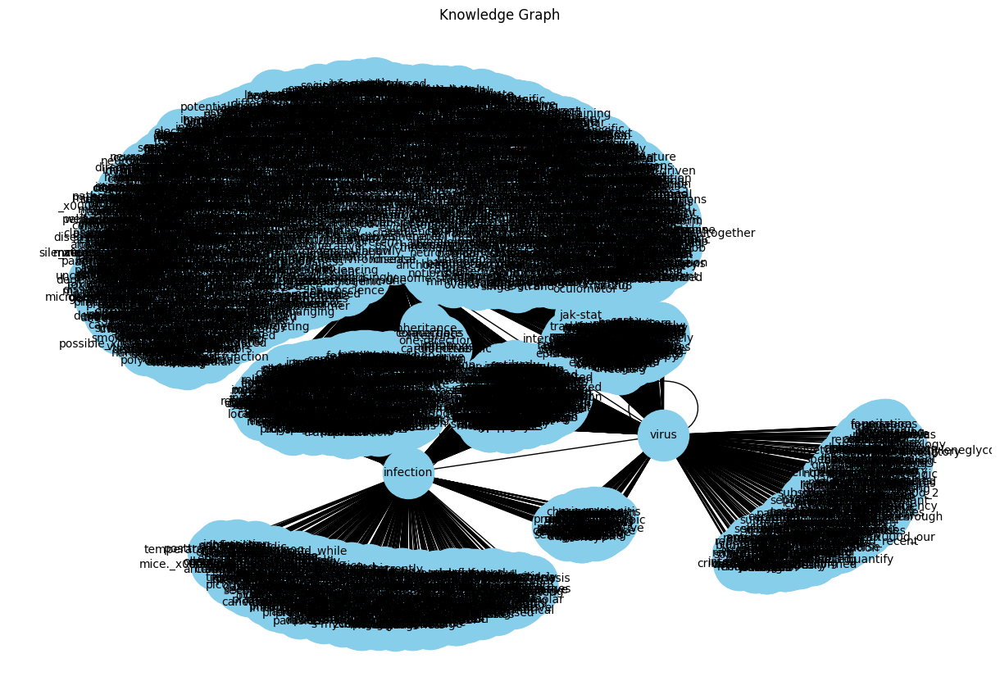

In [ ]:
# Initialize a graph
G = nx.Graph()

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Extract relationships based on keywords
    for i, token in enumerate(tokens):
        if token == 'disease':
            for j in range(i - 5, i + 6):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])
        elif token == 'virus' or token == 'infection':
            for j in range(i - 5, i + 6):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])

# Plot the knowledge graph
pos = nx.spring_layout(G, seed=42)  # Layout for visualization
plt.figure(figsize=(12, 8))
nx.draw(G, pos, with_labels=True, font_size=10, node_size=2000, node_color='skyblue')
plt.title("Knowledge Graph")
plt.show()


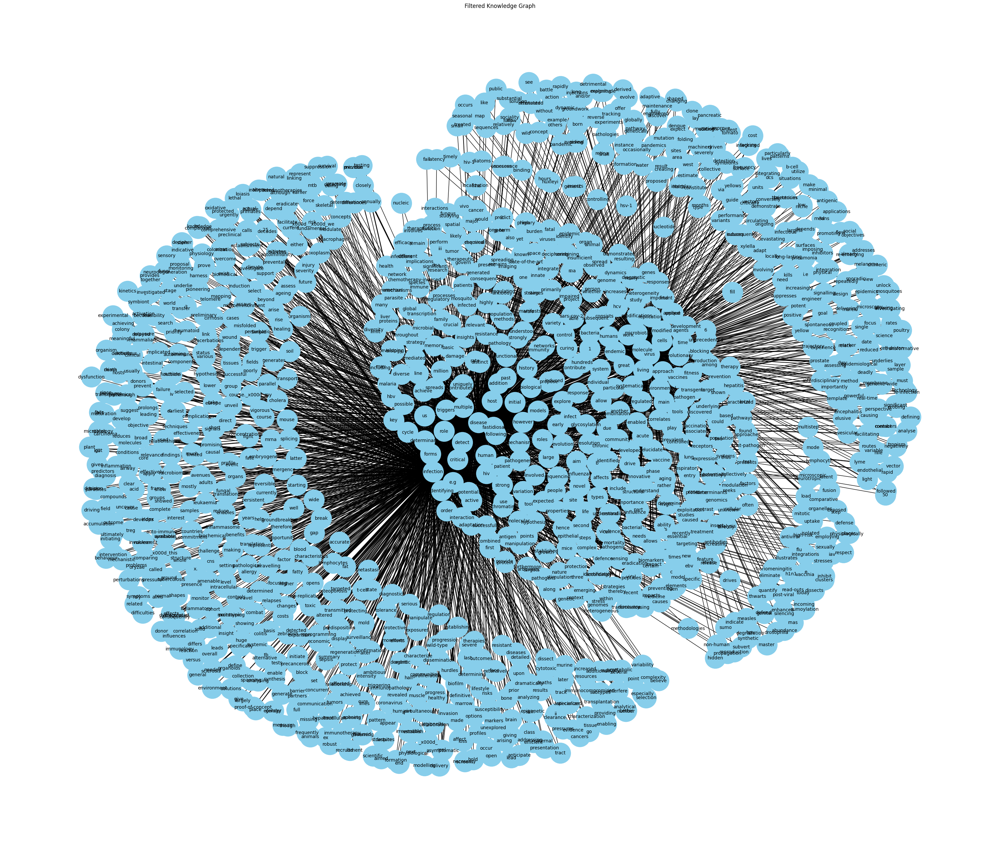

In [ ]:
# Initialize a graph
G = nx.Graph()

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Extract relationships based on keywords
    for i, token in enumerate(tokens):
        if token == 'disease':
            for j in range(i - 5, i + 6):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])
        elif token == 'virus' or token == 'infection':
            for j in range(i - 5, i + 6):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])

# Filter nodes with degree > 1
filtered_nodes = [node for node in G.nodes if G.degree[node] > 1]

# Create a subgraph with filtered nodes
H = G.subgraph(filtered_nodes)

# Plot the knowledge graph
pos = nx.spring_layout(H, seed=42)  # Layout for visualization
plt.figure(figsize=(30, 25))
nx.draw(H, pos, with_labels=True, font_size=10, node_size=2000, node_color='skyblue')
plt.title("Filtered Knowledge Graph")
plt.show()

In [ ]:
# Drawing Knowledge graph using 2 words before and after

In [ ]:
# Initialize a dictionary to store relationships
knowledge_graph = {}

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Extract relationships based on keywords
    for i, token in enumerate(tokens):
        if token == 'disease':
            for j in range(i - 2, i + 3):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    if token not in knowledge_graph:
                        knowledge_graph[token] = set()
                    knowledge_graph[token].add(tokens[j])
        elif token == 'virus' or token == 'infection':
            for j in range(i - 2, i + 3):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    if token not in knowledge_graph:
                        knowledge_graph[token] = set()
                    knowledge_graph[token].add(tokens[j])

# Print the knowledge graph
for entity, related_entities in knowledge_graph.items():
    print(f"{entity}: {', '.join(related_entities)}")

disease: smut, used, aggravation, condition, pre, systemic, kidney, milieu, malignant, autoantibodies, conditions, susceptibility/prognosis._x000d_, researchers, photoreceptor, 3, microglia, pelizaeus-merzbacher, recessive, 2.3, acute, incidence, incorporates, cure, translates, determine, cellular, samples, curing, 2, pd, upon, types, also, define, namely, cancer, implications, wild, mapping, arthropod, “, circuits, cystic, force, effecting, rat, sars-cov-2-induced, asymptomatic, 198, includes, symptoms, unfortunately, energy, replace, host, due, living, techniques, advances, projects, ad, remain, afflicts, among, colonic, respiratory, hcv-induced, low-income, airway, drivers, valve, chemotherapy, placental, impacts, swedish, go, e.g., induced, cerebellar, however, establishing, contributions, considered, map, underlies, indicators, heart, activity, divisions, autoantibody-positive, tumor, space, cll, ataxia, non-communicable, distal, bouts, requires, cardiovascular, allele, medication

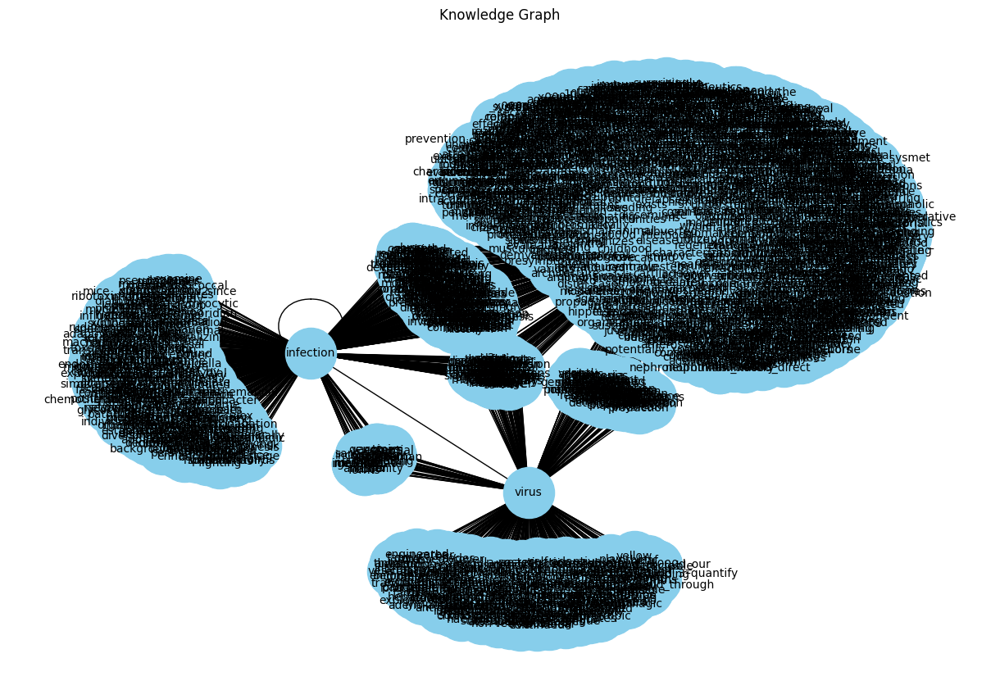

In [ ]:
# Initialize a graph
G = nx.Graph()

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Extract relationships based on keywords
    for i, token in enumerate(tokens):
        if token == 'disease':
            for j in range(i - 2, i + 3):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])
        elif token == 'virus' or token == 'infection':
            for j in range(i - 2, i + 3):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])

# Plot the knowledge graph
pos = nx.spring_layout(G, seed=42)  # Layout for visualization
plt.figure(figsize=(12, 8))
nx.draw(G, pos, with_labels=True, font_size=10, node_size=2000, node_color='skyblue')
plt.title("Knowledge Graph")
plt.show()


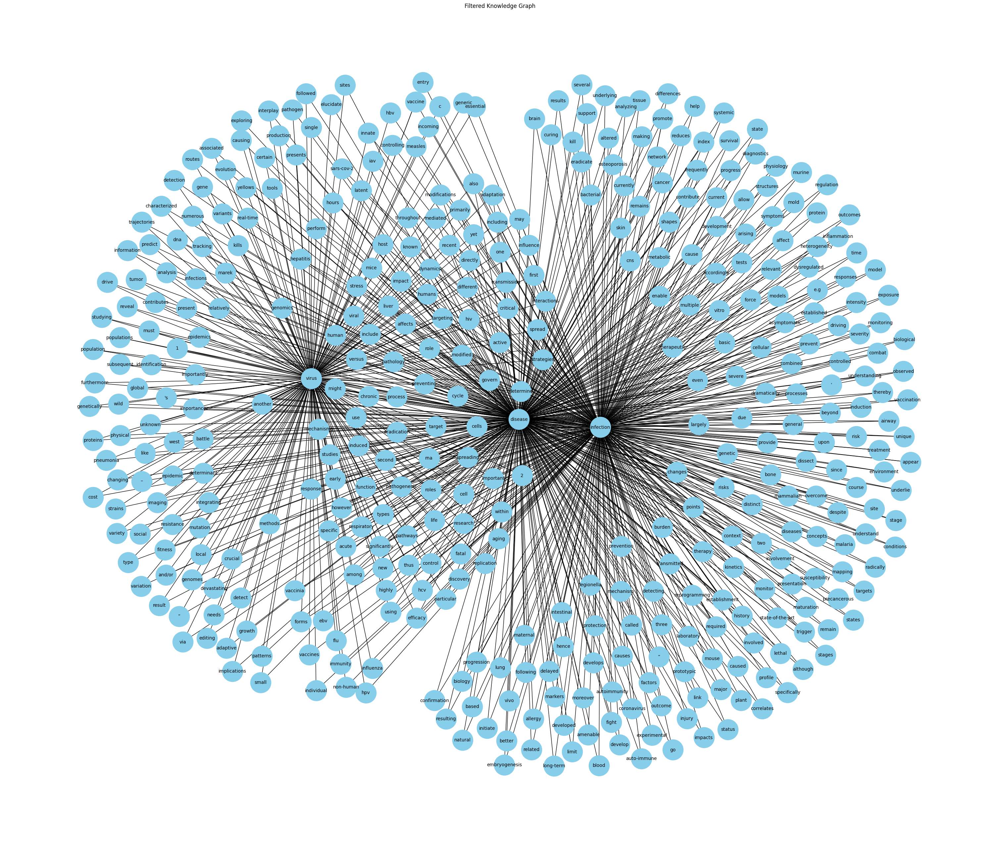

In [ ]:
# Initialize a graph
G = nx.Graph()

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    abstract = row["_abstract"]

    # Skip if abstract is None
    if pd.isnull(abstract):
        continue

    # Tokenize the abstract
    tokens = word_tokenize(abstract.lower())

    # Extract relationships based on keywords
    for i, token in enumerate(tokens):
        if token == 'disease':
            for j in range(i - 2, i + 3):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])
        elif token == 'virus' or token == 'infection':
            for j in range(i - 2, i + 3):
                if j != i and 0 <= j < len(tokens) and tokens[j] not in stop_words:
                    G.add_edge(token, tokens[j])

# Filter nodes with degree > 1
filtered_nodes = [node for node in G.nodes if G.degree[node] > 1]

# Create a subgraph with filtered nodes
H = G.subgraph(filtered_nodes)

# Plot the knowledge graph
pos = nx.spring_layout(H, seed=42)  # Layout for visualization
plt.figure(figsize=(30, 25))
nx.draw(H, pos, with_labels=True, font_size=10, node_size=2000, node_color='skyblue')
plt.title("Filtered Knowledge Graph")
plt.show()